In [48]:
import xarray as xr 
import matplotlib.pyplot as plt
import cmocean as cmo 
import pandas as pd 
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import numpy as np


# Start date 
start_date = '2024-08-10'
end_date = pd.to_datetime(start_date) + pd.Timedelta(seconds=(10*9999))
dates = pd.date_range(start_date, end_date, freq='10s')

# python -m ipykernel install --user --name schimpy --display-name Schimpy

In [80]:
# open datasets
hydro = xr.open_dataset('run_hydro/HYDRO.nc', decode_timedelta=False)
truth = xr.open_dataset('forward_phyto/phyto_TRUTH.nc', decode_timedelta=False)
z = hydro["z"]

NITER =60 

guess = {} 
for i in range(1, NITER):
    guess[i] = xr.open_dataset(f'forward_phyto/forward_{i}.nc', decode_timedelta=False)

# Read in adjoint 
adjoint = {}
for i in range(1, NITER):
    adjoint[i] = xr.open_dataset(f'backward_lambda/adjoint_{i}.nc', decode_timedelta=False)


# grad = guess["gamma"].values * adj["lambda"].values


[np.float64(0.009630917243841845), np.float64(0.009620109192306162), np.float64(0.009609626764532872), np.float64(0.009599459286325563), np.float64(0.009589596482768572), np.float64(0.009580028460610244), np.float64(0.009570745691596877), np.float64(0.009561738996665937), np.float64(0.009552999530956237), np.float64(0.009544518769577867), np.float64(0.009536288494109913), np.float64(0.009528300779755227), np.float64(0.009520547983137435), np.float64(0.009513022730715715), np.float64(0.0095057179077317), np.float64(0.009498626647706194), np.float64(0.009491742322443273), np.float64(0.009485058532488025), np.float64(0.009478569098051046), np.float64(0.00947226805034958), np.float64(0.00946614962333609), np.float64(0.009460208245825528), np.float64(0.009454438533969056), np.float64(0.009448835284062795), np.float64(0.00944339346568649), np.float64(0.009438108215148004), np.float64(0.009432974829197955), np.float64(0.009427988759046555), np.float64(0.009423145604613275), np.float64(0.00941

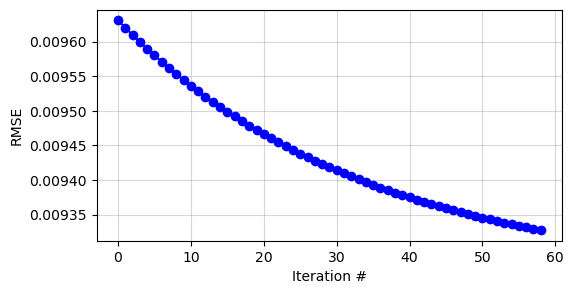

In [81]:

true = truth.algae1.values[-1,:]

guess_algae = [] 

for i in range(1,NITER):
    alg = guess[i].algae1.values[-1,:]
    rmse = (np.sqrt(np.mean((true - alg)**2)))
    guess_algae.append(rmse)

fig = plt.figure(figsize=(6,3))
ax = fig.add_subplot(111)
ax.plot(guess_algae, '-o', label='guess algae RMSE', color='blue')
ax.grid(alpha = 0.5) 
ax.set_xlabel("Iteration #")
ax.set_ylabel("RMSE")

print(guess_algae)

Text(0.5, 1.0, 'Difference between 30 and true ALGAE')

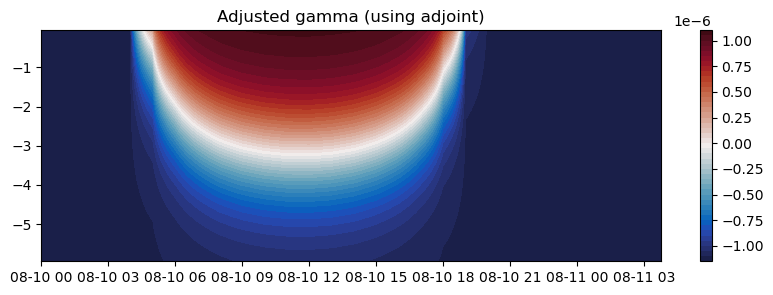

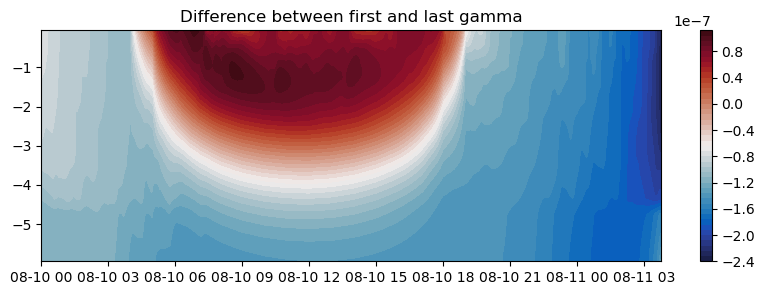

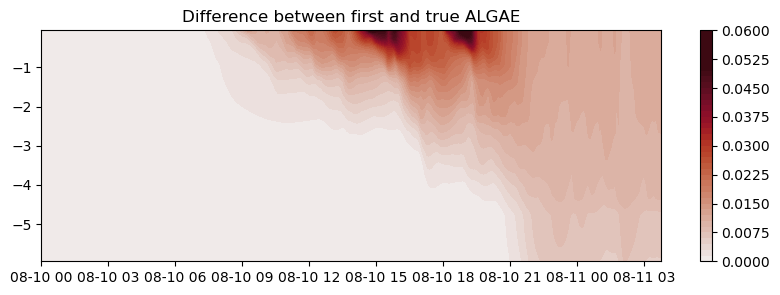

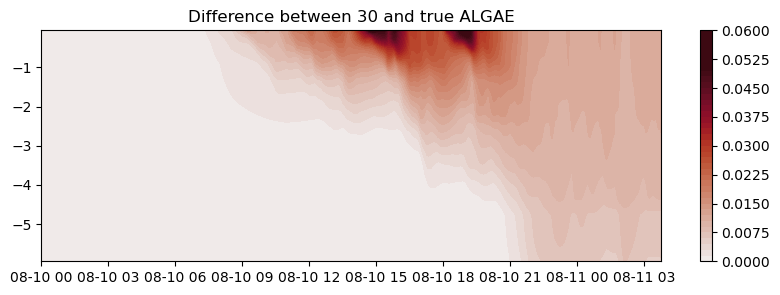

In [66]:
# Contour plots of gamma 
fig = plt.figure(figsize=(10, 3))
ax = fig.add_subplot(111)
c = ax.contourf(dates, -z, adjoint[1].gamma.values.T, levels=50, cmap=cmo.cm.balance)#, vmin=1.5e-7, vmax=1.5e-7)
plt.colorbar(c)
plt.title('Adjusted gamma (using adjoint)')


# fig = plt.figure(figsize=(10, 3))
# ax = fig.add_subplot(111)
# c = ax.contourf(dates, -z, adj4.gamma.values.T, levels=50, cmap=cmo.cm.balance)#, vmin=1.5e-7, vmax=1.5e-7)
# plt.colorbar(c)
# plt.title('First guess @ gamma')

fig = plt.figure(figsize=(10, 3))
ax = fig.add_subplot(111)
c = ax.contourf(dates, -z, (adjoint[1].gamma.values.T - adjoint[NITER-1].gamma.values.T), levels=50, cmap=cmo.cm.balance)#, vmin=1.5e-7, vmax=1.5e-7)
plt.colorbar(c)
plt.title('Difference between first and last gamma')





fig = plt.figure(figsize=(10, 3))
ax = fig.add_subplot(111)
c = ax.contourf(dates, -z, abs(guess[1].algae1.values.T - truth.algae1.values.T), levels=50, cmap=cmo.cm.balance, vmin=-0.05, vmax=0.05)#, vmin=1.5e-7, vmax=1.5e-7)
plt.colorbar(c)
plt.title('Difference between first and true ALGAE')

fig = plt.figure(figsize=(10, 3))
ax = fig.add_subplot(111)
c = ax.contourf(dates, -z, abs(guess[49].algae1.values.T - truth.algae1.values.T), levels=50, cmap=cmo.cm.balance, vmin=-0.05, vmax=0.05)#, vmin=1.5e-7, vmax=1.5e-7)
plt.colorbar(c)
plt.title('Difference between 30 and true ALGAE')


# fig = plt.figure(figsize=(10, 3))
# ax = fig.add_subplot(111)
# diff = (guess.gamma.values.T - truth.gamma.values.T)
# print(np.min(diff), np.max(diff))
# c = ax.contourf(dates, -z, diff , levels=50, cmap=cmo.cm.deep_r, vmin=-1.5e-5, vmax=0)
# plt.colorbar(c)
# plt.title('(Guessed gamma - True gamma)')

In [ ]:
frames = []

start = 0
end = 8998 
spacing = 6 
times = [dates[i] for i in range(start, end, spacing)]
# Create a frame for each phase shift
for i in range(start, end, spacing):
    h1 = go.Scatter(x=guess[NITER-1]["algae1"][i,:], y=-z, name= "Best guess", mode='lines', line=dict(width=2, color="blue"))  
    h3 = go.Scatter(x=guess[1]["algae1"][i,:], y=-z, name= "Guess gamma", mode='lines', line=dict(width=2, color="pink"))
    h2 = go.Scatter(x=truth["algae1"][i,:], y=-z, name= "True gamma",  mode='lines', line=dict(width=2, color="green"))  
    frames.append(go.Frame(data=[h1, h2, h3], name=str(dates[i])))

# Initial figure
i = 0 
h1 = go.Scatter(x=guess[NITER-1]["algae1"][i,:], y=-z, name= "Best guess", mode='lines', line=dict(width=2, color="blue"))  
h2 = go.Scatter(x=truth["algae1"][i,:], y=-z, name= "Truth",  mode='lines', line=dict(width=2, color="green"))   
h3 = go.Scatter(x=guess[1]["algae1"][i,:], y=-z, name= "First gamma", mode='lines', line=dict(width=2, color="pink"))

fig = go.Figure( data=[h1, h2, h3],
                layout=go.Layout(
                    title='Algae Concentration in the Water Column',
                    xaxis=dict(range=[0, 1e-1], title='Algae Concentration (cells/mL)'),
                    yaxis=dict(range=[-6, 0], title='Water Depth (m)'),
                    updatemenus=[{
                    'type': 'buttons',
                    'showactive': False,
                    'buttons': [{
                        'label': 'Play',
                        'method': 'animate',
                        'args': [None, {
                            'frame': {'duration': 200, 'redraw': True},
                            'fromcurrent': True
                        }]
                    }]
                }],
                sliders=[{
                    'active': 0,
                    'steps': [{'label': t.strftime('%b/%d %H:%M'),'method': 'animate', 'args': [[str(t)], {'mode': 'immediate', 'frame': {'duration': 0}, 'transition': {'duration': 0}}]} for t in times]
                }]
            ),
    frames=frames
)
fig.show()


In [10]:
frames = []

start = 9998
end = 0
spacing = -50 
times = [dates[i] for i in range(start, end, spacing)]
# Create a frame for each phase shift
for i in range(start, end, spacing):
    # print(adj["lambda"][i,:][0:5].values)
    h1 = go.Scatter(x=adj["lambda"][i,:], y=-z, name= "Adjoint", mode='lines', line=dict(width=2, color="blue"))  
    frames.append(go.Frame(data=[h1], name=str(dates[i])))

# Initial figure
h1 = go.Scatter(x=adj["lambda"][start,:], y=-z, name= "Adjoint", mode='lines', line=dict(width=2, color="blue"))  
fig = go.Figure( data=[h1],
                layout=go.Layout(
                    title='Adjoint variable',
                    xaxis=dict(range=[-0.05, 0.05], title='Adjoint Variable [-]'),
                    yaxis=dict(range=[-6, 0], title='Water Depth (m)'),
                    updatemenus=[{
                    'type': 'buttons',
                    'showactive': False,
                    'buttons': [{
                        'label': 'Play',
                        'method': 'animate',
                        'args': [None, {
                            'frame': {'duration': 200, 'redraw': True},
                            'fromcurrent': True
                        }]
                    }]
                }],
                sliders=[{
                    'active': 0,
                    'steps': [{'label': t.strftime('%b/%d %H:%M'),'method': 'animate', 'args': [[str(t)], {'mode': 'immediate', 'frame': {'duration': 0}, 'transition': {'duration': 0}}]} for t in times]
                }]
            ),
    frames=frames
)
fig.show()


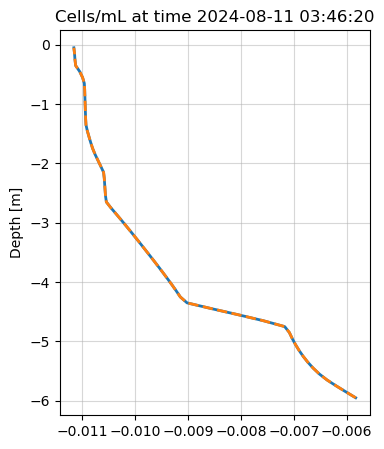

(9999, 60)


In [7]:

plt.figure(figsize=(4, 5))

i = -1 
diff = guess["algae1"][i,:] - truth["algae1"][i,:]

plt.plot(diff, -z, linewidth=2)
plt.plot(adj["lambda"][i,:]/2 , -z, '--',linewidth=2)
# plt.plot(flip(diff), -z, linewidth=2)
plt.title(f"Cells/mL at time %s" % dates[-1])
plt.ylabel('Depth [m]')
ax = plt.gca()
ax.grid(alpha=0.5)
plt.show()

print(adj["lambda"].shape)


In [69]:
# TURBULENT DIFFUSIVITY

frames = []

start = 0
end = 8998
spacing = 50 
times = [dates[i] for i in range(start, end, spacing)]
# Create a frame for each phase shift
for i in range(start, end, spacing):
    h1 = go.Scatter(x=hydro["Kz"][i,:], y=-z, name= "Turbulent Diffusivity", mode='lines', line=dict(width=2, color="blue"))  
    frames.append(go.Frame(data=[h1], name=str(dates[i])))

# Initial figure
h1 = go.Scatter(x=hydro["Kz"][i,:], y=-z, name= "Turbulent Diffusivity", mode='lines', line=dict(width=2, color="blue"))  
fig = go.Figure( data=[h1],
                layout=go.Layout(
                    title='TURBULENT DIFFUSIVITY',
                    xaxis=dict(range=[0, 0.01], title='Adjoint Variable [-]'),
                    yaxis=dict(range=[-6, 0], title='Water Depth (m)'),
                    updatemenus=[{
                    'type': 'buttons',
                    'showactive': False,
                    'buttons': [{
                        'label': 'Play',
                        'method': 'animate',
                        'args': [None, {
                            'frame': {'duration': 200, 'redraw': True},
                            'fromcurrent': True
                        }]
                    }]
                }],
                sliders=[{
                    'active': 0,
                    'steps': [{'label': t.strftime('%b/%d %H:%M'),'method': 'animate', 'args': [[str(t)], {'mode': 'immediate', 'frame': {'duration': 0}, 'transition': {'duration': 0}}]} for t in times]
                }]
            ),
    frames=frames
)
fig.show()


<xarray.Dataset> Size: 5MB
Dimensions:  (z: 60, time: 9999)
Coordinates:
  * z        (z) float32 240B 5.95 5.85 5.75 5.65 5.55 ... 0.35 0.25 0.15 0.05
  * time     (time) timedelta64[ns] 80kB 00:00:01 00:00:02 ... 02:46:38 02:46:39
Data variables:
    lambda   (time, z) float64 5MB ...


/tmp/ipykernel_1299565/2487831615.py:1: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset('adjoint.nc')


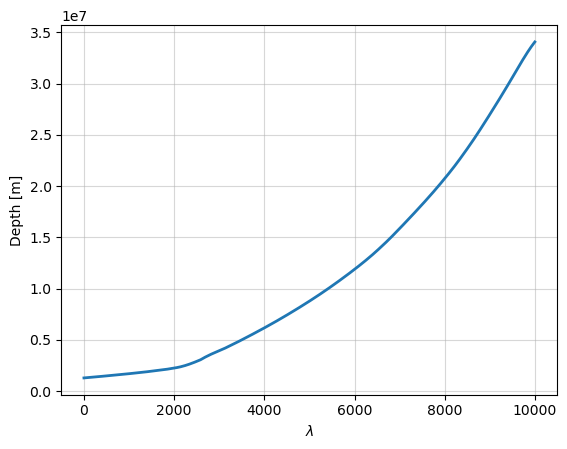

2024-08-10 05:33:00
2024-08-10 05:16:20
2024-08-10 04:59:40
2024-08-10 04:43:00
2024-08-10 04:26:20
2024-08-10 04:09:40
2024-08-10 03:53:00
2024-08-10 03:36:20
2024-08-10 03:19:40
2024-08-10 03:03:00
2024-08-10 02:46:20
2024-08-10 02:29:40
2024-08-10 02:13:00
2024-08-10 01:56:20
2024-08-10 01:39:40
2024-08-10 01:23:00
2024-08-10 01:06:20
2024-08-10 00:49:40
2024-08-10 00:33:00
2024-08-10 00:16:20


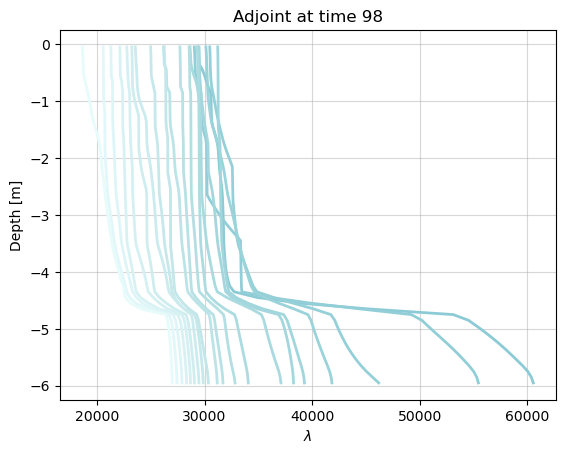

In [ ]:

ds = xr.open_dataset('adjoint.nc')

z = -ds['z'].values
time = ds['time'].values

plt.figure()
plt.plot(ds['lambda'].sum(dim='z'), linewidth=2)
plt.xlabel(r'$\lambda$')
plt.ylabel('Depth [m]')
ax = plt.gca()
ax.grid(alpha=0.5)
plt.show()




plt.figure()
for i in range(1998, 0, -100):
    print(dates[i])
    plt.plot(ds['lambda'].isel(time=i), z, color=cmo.cm.ice_r(i/10000), linewidth=2)
    # print("At time %d, sum(lambda) = %f" % (i, ds['lambda'].isel(time=i).sum()))
plt.title(f"Adjoint at time %d" % i)
plt.xlabel(r'$\lambda$')
plt.ylabel('Depth [m]')
ax = plt.gca()
# ax.set_xlim(-1e4,1e4)
ax.grid(alpha=0.5)
plt.show()


/tmp/ipykernel_1299565/4253105365.py:6: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset('../forward_phyto/phyto_TRUTH.nc')


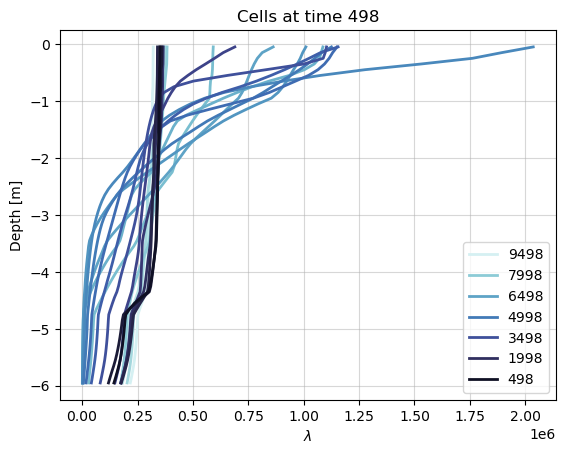

In [40]:
import matplotlib.pyplot as plt
import cmocean as cmo 



ds = xr.open_dataset('../forward_phyto/phyto_TRUTH.nc')

z = ds['z'].values
time = ds['time'].values


plt.figure()
for i in range(9998, 0, -500):
    if i%3 == 0 :
        plt.plot(ds['algae1'].isel(time=i), -z, color=cmo.cm.ice(i/10000), linewidth=2, label=i)
    else : 
        plt.plot(ds['algae1'].isel(time=i), -z, color=cmo.cm.ice(i/10000), linewidth=2)
plt.title(f"Cells at time %d" % i)
plt.xlabel(r'$\lambda$')
plt.ylabel('Depth [m]')
ax = plt.gca()
ax.legend()
# ax.set_xlim(0,4)
ax.grid(alpha=0.5)
plt.show()

At time 9998, sum(lambda) = 0.503609
At time 9498, sum(lambda) = 0.251445
At time 8998, sum(lambda) = 0.103097
At time 8498, sum(lambda) = 0.213268
At time 7998, sum(lambda) = 0.164009
At time 7498, sum(lambda) = 0.132224
At time 6998, sum(lambda) = 0.036655
At time 6498, sum(lambda) = 0.009403
At time 5998, sum(lambda) = 0.013678
At time 5498, sum(lambda) = 0.002634
At time 4998, sum(lambda) = 0.004618
At time 4498, sum(lambda) = 0.006982
At time 3998, sum(lambda) = 0.003122
At time 3498, sum(lambda) = 0.009544
At time 2998, sum(lambda) = 0.007737
At time 2498, sum(lambda) = 0.166115
At time 1998, sum(lambda) = 0.126441
At time 1498, sum(lambda) = 0.292678
At time 998, sum(lambda) = 0.359232
At time 498, sum(lambda) = 0.447689


/tmp/ipykernel_1702945/913905150.py:8: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset('../run_hydro/HYDRO.nc')


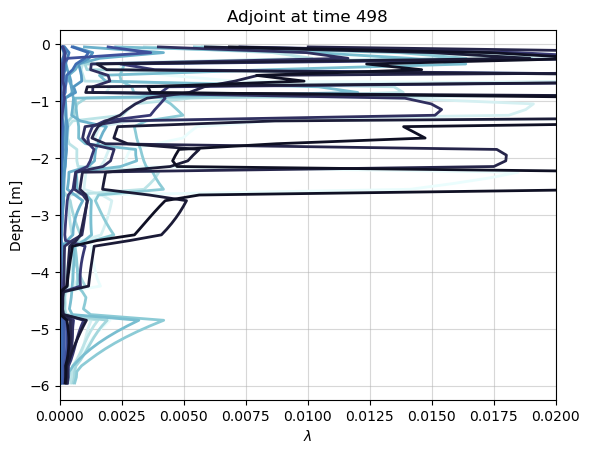

In [ ]:
import matplotlib.pyplot as plt
import cmocean as cmo 

z = ds['z'].values
time = ds['time'].values


ds = xr.open_dataset('../run_hydro/HYDRO.nc')

plt.figure()
for i in range(9998, 0, -200):
    plt.plot(ds['Kz'].isel(time=i), -z, color=cmo.cm.ice(i/10000), linewidth=2)
    print("At time %d, sum(lambda) = %f" % (i, ds['Kz'].isel(time=i).sum()))
plt.title(f"Adjoint at time %d" % i)
plt.xlabel(r'$\lambda$')
plt.ylabel('Depth [m]')
ax = plt.gca()
ax.set_xlim(0,2e-2)
ax.grid(alpha=0.5)
plt.show()